## Advanced Lane Finding Project

As per the rubric, the goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## Compute Camera Calibration and Undistort Images

In [1]:
import numpy as np
import cv2
import glob
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

# Make a list of calibration images
project_path = "/home/james/Documents/CarND-AdvLaneLines-P4/"
path_to_cal_images= project_path + "camera_cal/"
images = glob.glob(path_to_cal_images + 'calibration*.jpg')

# Arrays to store object points and image points from all the images.
objpoints = [] # 3D co-ordinates of corners in un-distorted image
imgpoints = [] # 2D co-ordinates of corners

# prepare object points, which will be the same for all calibration images:
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)


for fname in images:
    # Load each image, compute chess board corners
    img =  mpimg.imread(fname)    
    gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY) 
    ret,corners = cv2.findChessboardCorners(gray, (9,6), None)
    
    if (ret == True): # If corners were found
        imgpoints.append(corners)
        objpoints.append(objp)
        image_name = fname.split('/')[-1]
        print(image_name +"\tFound corners, saving...")
        test = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        cv2.imwrite(path_to_cal_images + "DrawCorners/" +image_name,test)
        
        # Display Chess Board Corners:
        '''
        plt.figure()
        plt.imshow(test)
        plt.title(fname.split('/')[-1])
        plt.axis('off')
        print("Added " + fname +" to imgpoints array")
        '''
        
print("Calibrating Camera...")
img_size = (gray.shape[1],gray.shape[0])
ret, mtx, dist, rvecs, tvecs =cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)
print("Done!")
    

calibration14.jpg	Found corners, saving...
calibration3.jpg	Found corners, saving...
calibration6.jpg	Found corners, saving...
calibration12.jpg	Found corners, saving...
calibration20.jpg	Found corners, saving...
calibration16.jpg	Found corners, saving...
calibration13.jpg	Found corners, saving...
calibration18.jpg	Found corners, saving...
calibration10.jpg	Found corners, saving...
calibration8.jpg	Found corners, saving...
calibration9.jpg	Found corners, saving...
calibration17.jpg	Found corners, saving...
calibration7.jpg	Found corners, saving...
calibration19.jpg	Found corners, saving...
calibration2.jpg	Found corners, saving...
calibration11.jpg	Found corners, saving...
calibration15.jpg	Found corners, saving...
Calibrating Camera...
Done!


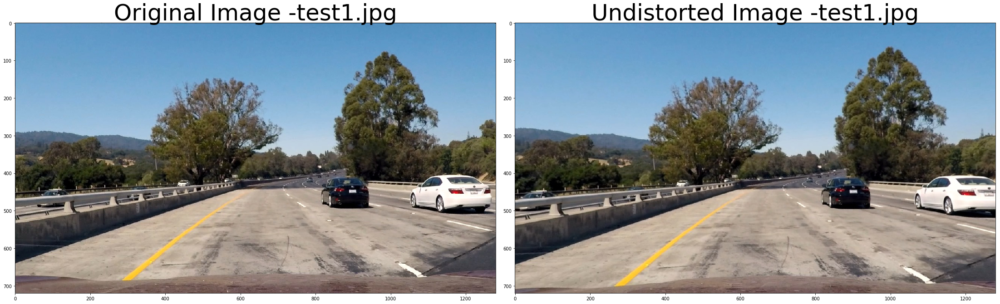

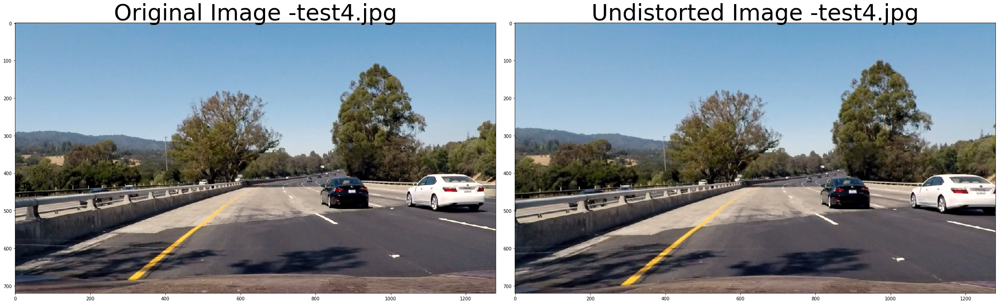

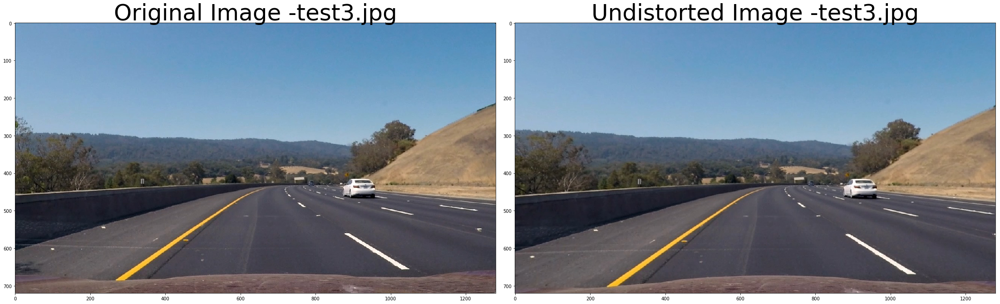

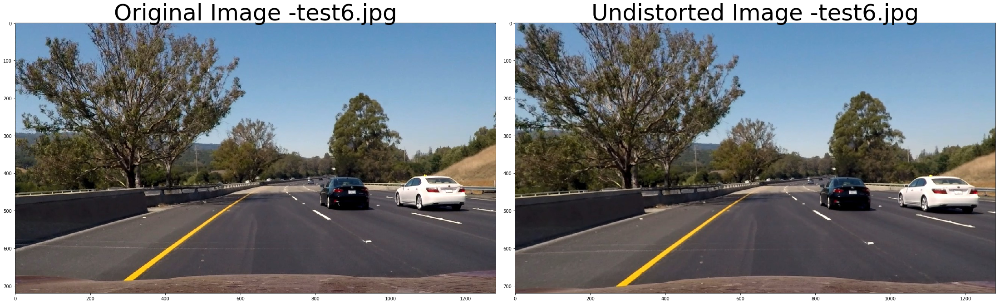

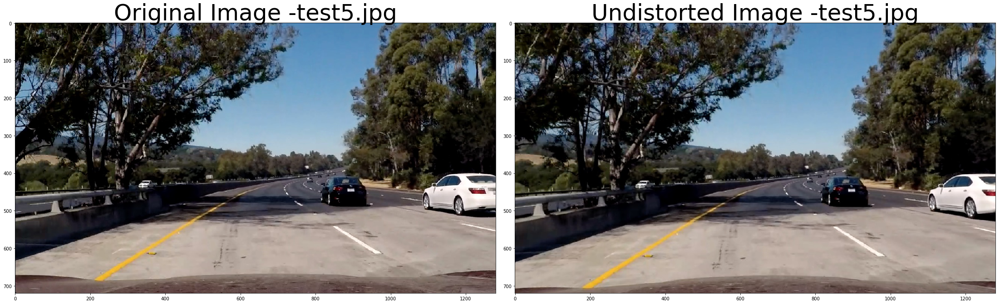

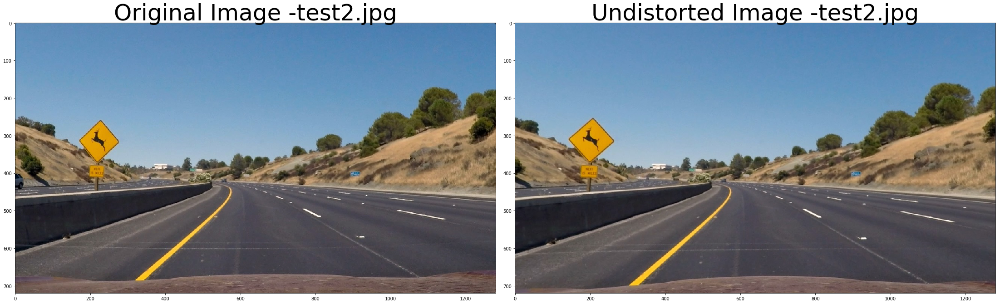

In [2]:
#Undistort test images
test_images = glob.glob(project_path + "test_images/test*.jpg")
for fname in test_images:
    test_img = mpimg.imread(fname)
    img_gray = cv2.cvtColor(test_img,cv2.COLOR_RGB2GRAY)
    undistorted = cv2.undistort(test_img, mtx,dist,None,mtx)    
    cv2.imwrite(project_path + "test_images/Undistorted/undist_"+fname.split('/')[-1] ,
                cv2.cvtColor(undistorted, cv2.COLOR_RGB2BGR))   
    
    #Show distorted / undistorted images side by side :

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(30, 15))
    f.tight_layout()
    ax1.imshow(test_img)
    ax1.set_title('Original Image -' + fname.split('/')[-1], fontsize=50)
    ax2.imshow(undistorted)
    ax2.set_title('Undistorted Image -' + fname.split('/')[-1], fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)



## Generate Binary Thresholded Image

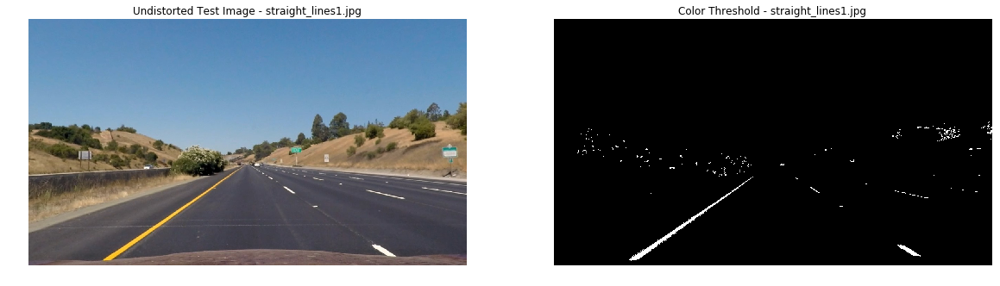

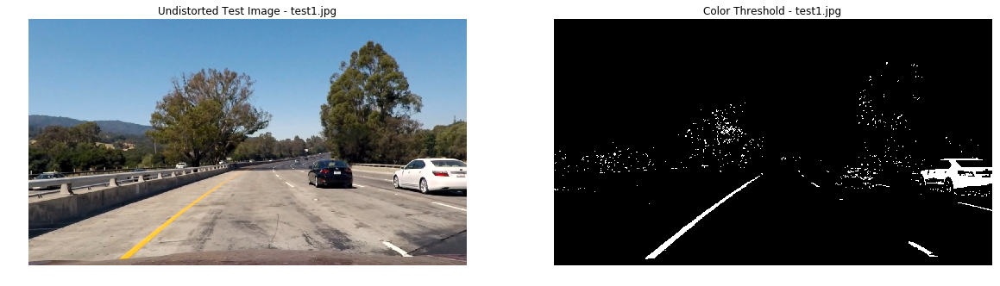

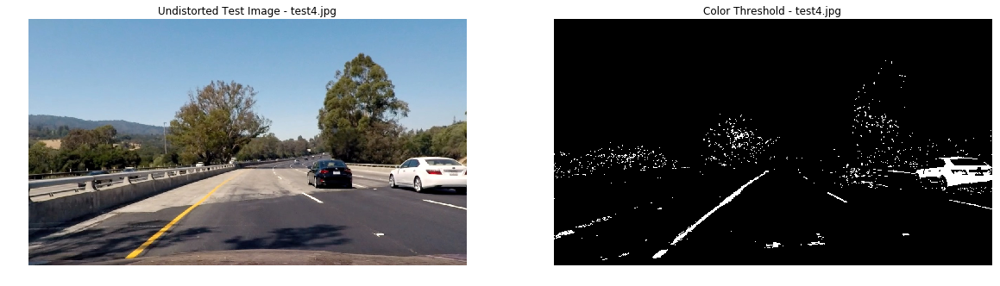

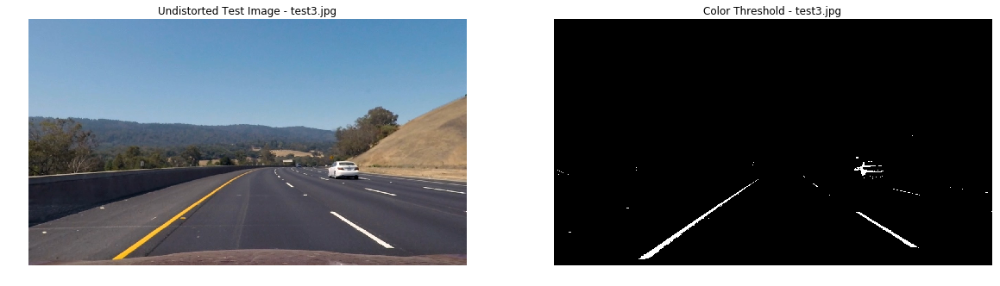

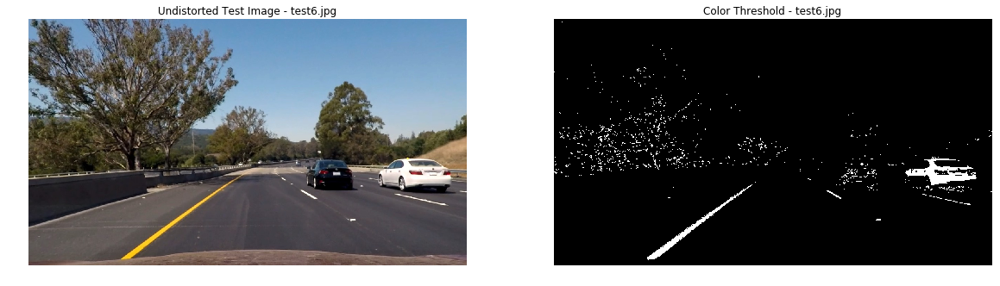

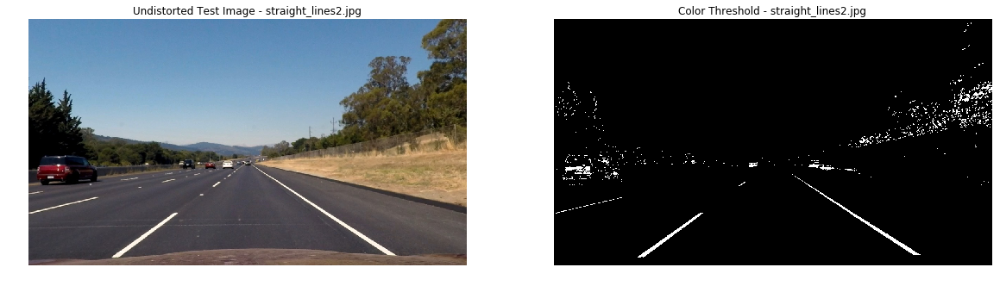

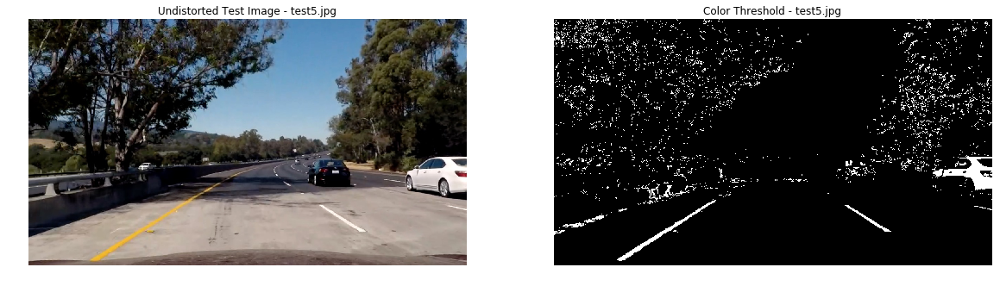

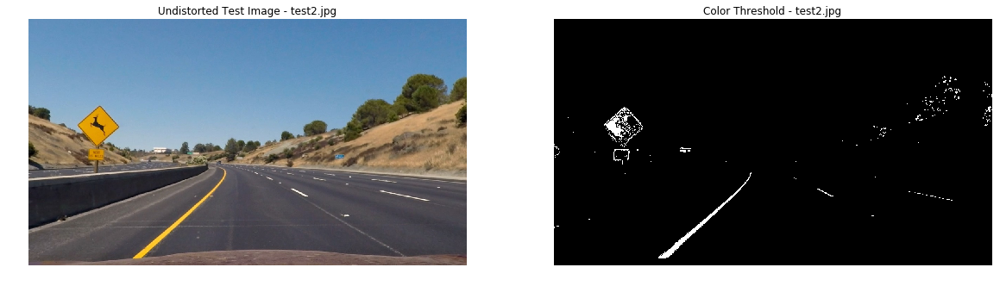

In [3]:
#Color Threshold

def color_threshold(img):
    # img = RGB format   
    
    # Isolate Red from RGB
    r_channel = img[:,:,0] 
        
    #Hue Lightness Saturation Conversion
    HLS = cv2.cvtColor(img,cv2.COLOR_RGB2HLS)
    h_channel = HLS[:,:,0]
    l_channel = HLS[:,:,1]
    s_channel = HLS[:,:,2]   
    
    #Generate Plots for HLS Channels:
    '''
    f, (ax1, ax2,ax3) = plt.subplots(1, 2, figsize=(20,10))  
    ax1.imshow(h_channel,cmap = 'gray')
    ax2.imshow(l_channel,cmap = 'gray')
    ax3.imshow(s_channel,cmap = 'gray')    
    '''
    
    # Thresholding Saturation (OK)   
    s_thresh_min = 150
    s_thresh_max = 220
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh_min) & (s_channel <= s_thresh_max)] = 1 
  
    
    # Thresholding Red (OK)
    r_thresh_min = 227
    r_thresh_max = 255
    r_binary = np.zeros_like(s_channel)
    r_binary[(r_channel >= r_thresh_min) & (r_channel <= r_thresh_max)] = 1
    
    # Combine Saturation & Red Thresholding
    combined_binary = np.zeros_like(r_binary)
    combined_binary[(r_binary == 1) | (s_binary == 1)] = 1 
    
    # Return binary color threshold
    return combined_binary
    

#Debugging color_threshold(img):

images = glob.glob(project_path + 'test_images/*.jpg')

for i,fname in enumerate(images):
    raw_img = mpimg.imread(fname) # import image into RGB format
    raw_img_undistort = cv2.undistort(raw_img, mtx,dist,None,mtx)  # undistort image   
    thresholded_image = color_threshold(raw_img_undistort) # generate color threshold image

    #Generate Plots:
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))  
    ax1.imshow(raw_img_undistort)
    ax1.set_title('Undistorted Test Image - '+fname.split('/')[-1])
    ax1.axis('off')   
    
    ax2.imshow(thresholded_image,cmap = 'gray')
    ax2.set_title('Color Threshold - '+fname.split('/')[-1])
    ax2.axis('off')



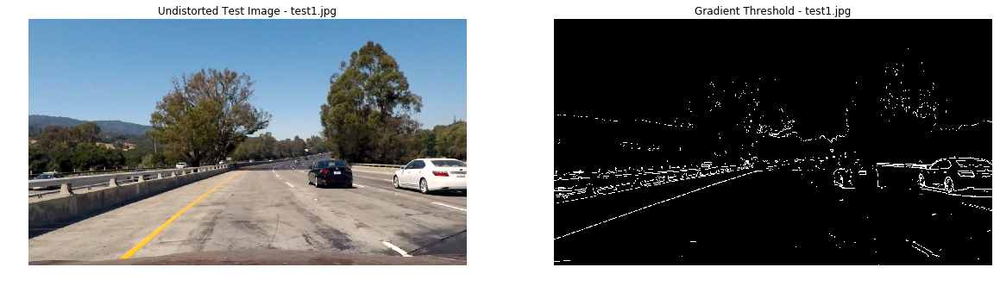

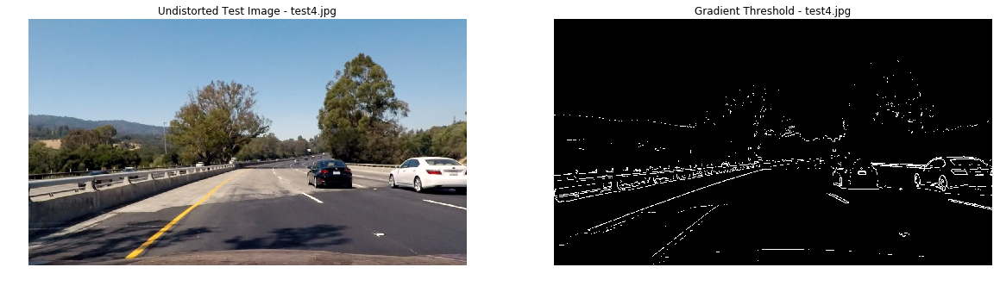

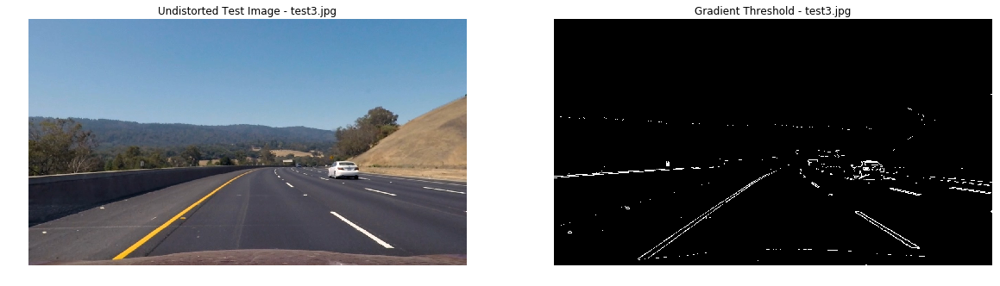

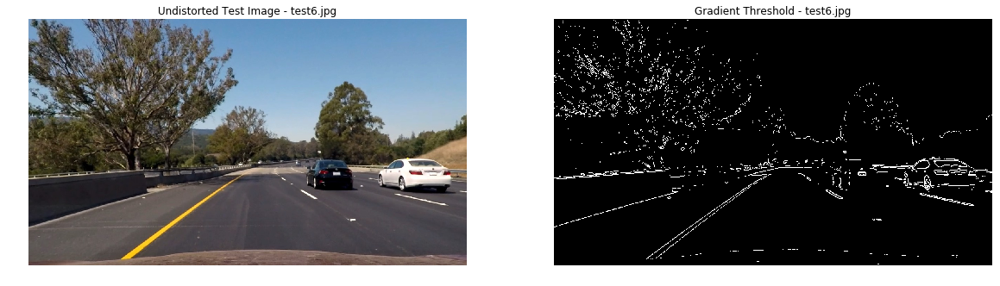

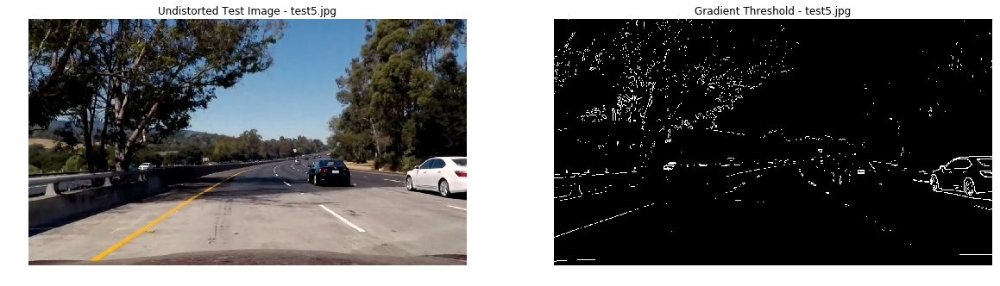

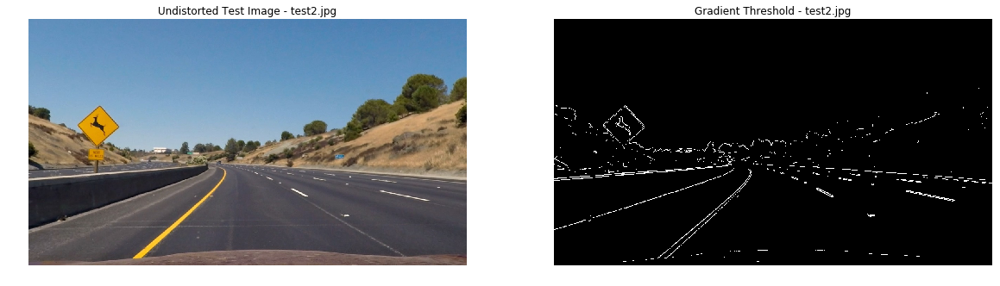

In [4]:
# Gradient Threshold

def gradient_threshold(img):
    # img = RGB format, compute to grayscale
    gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    
    # Compute x & y gradients :
    sobel_kernel = 9 
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, sobel_kernel)
    sobely = cv2.Sobel(gray,cv2.CV_64F,0,1,sobel_kernel) 
    
    # Thresholding  Angle (NOK)
    '''
    grad_direction = np.arctan2 ( np.absolute(sobely), np.absolute(sobelx) )    
    angle_binary = np.zeros_like(grad_direction)
    angle_thresh_min = 45*np.pi/180
    angle_thresh_max = 75*np.pi/180
    angle_binary[(grad_direction >= angle_thresh_min)&(grad_direction <= angle_thresh_max)] = 1    
    '''
    # Thresholding gradient magnitude (OK)
    grad_mag = np.sqrt(sobelx**2 + sobely**2)
    scale_factor = np.max(grad_mag)/255 
    grad_mag = (grad_mag/scale_factor).astype(np.uint8) 
    mag_thresh_min = 75
    mag_thresh_max = 225
    mag_binary = np.zeros_like(grad_mag)
    mag_binary[(grad_mag >= mag_thresh_min) & (grad_mag <= mag_thresh_max)] = 1  
   
    return mag_binary

#Debugging gradient_threshold(img):

images = glob.glob(project_path + 'test_images/test*.jpg')

for i,fname in enumerate(images):
    raw_img = mpimg.imread(fname) # import image into RGB format    
    raw_img_undistort = cv2.undistort(raw_img, mtx,dist,None,mtx) # undistort image       
    thresholded_image = gradient_threshold(raw_img_undistort) # generate color threshold image

    #Generate Plots
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))    
    ax1.imshow(raw_img_undistort)
    ax1.set_title('Undistorted Test Image - '+fname.split('/')[-1])
    ax1.axis('off')   
    
    ax2.imshow(thresholded_image,cmap = 'gray')
    ax2.set_title('Gradient Threshold - ' +fname.split('/')[-1])
    ax2.axis('off')



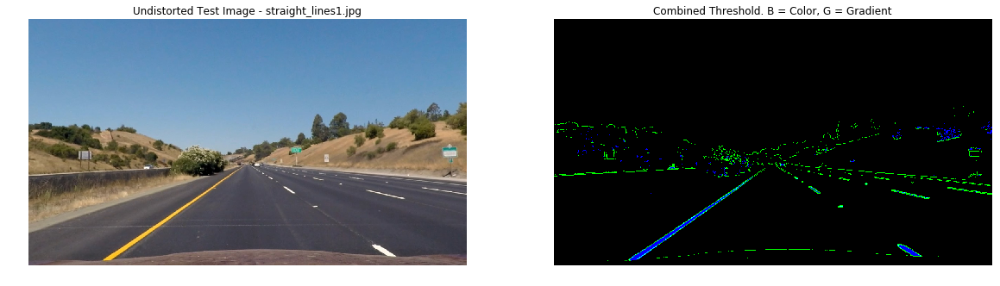

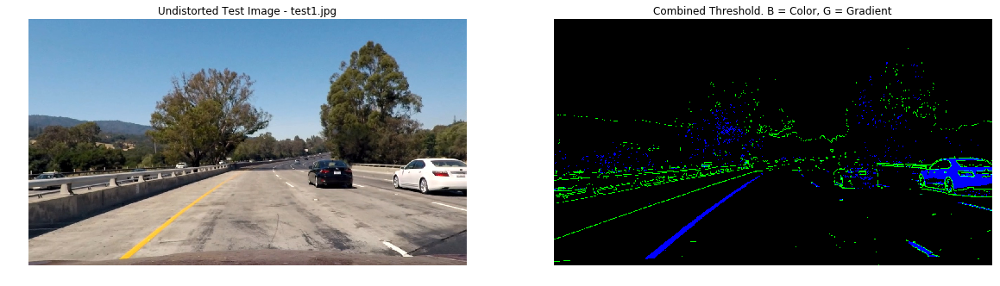

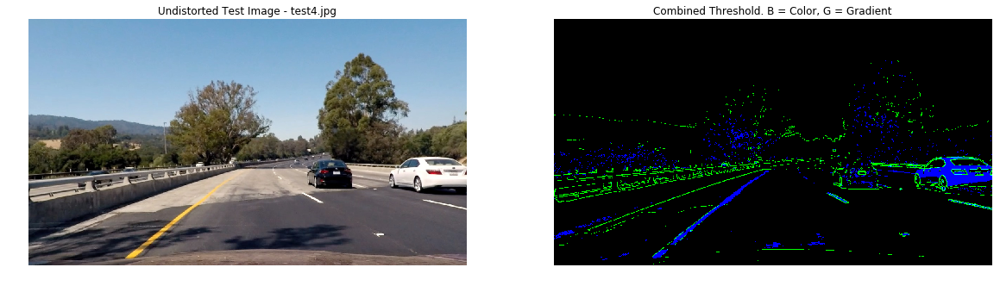

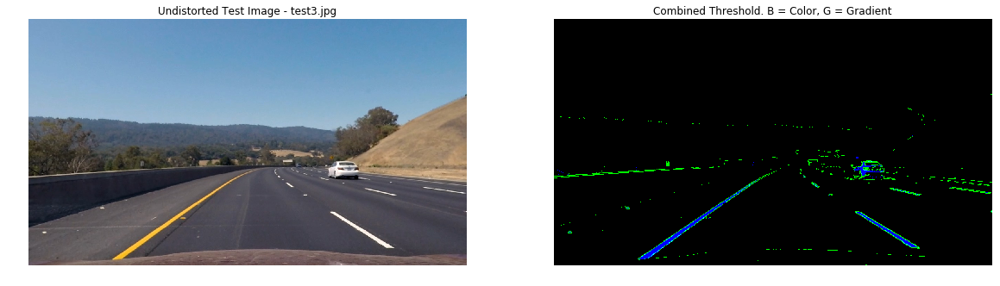

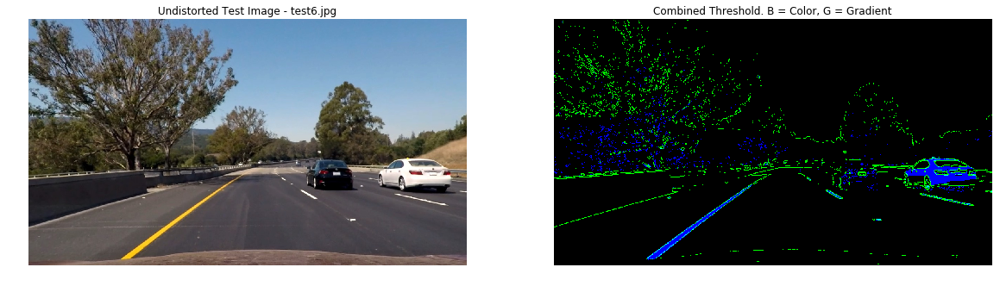

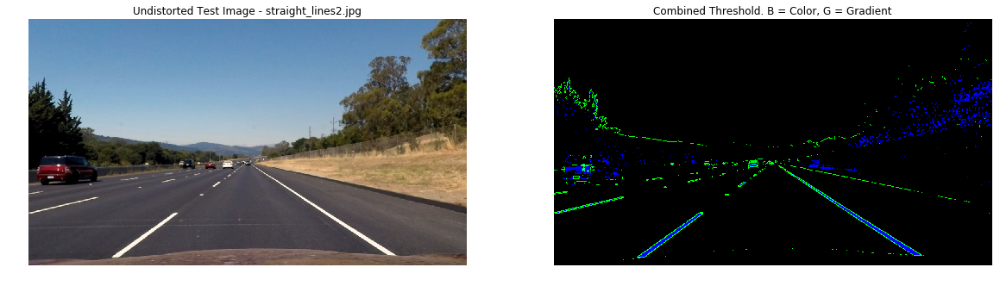

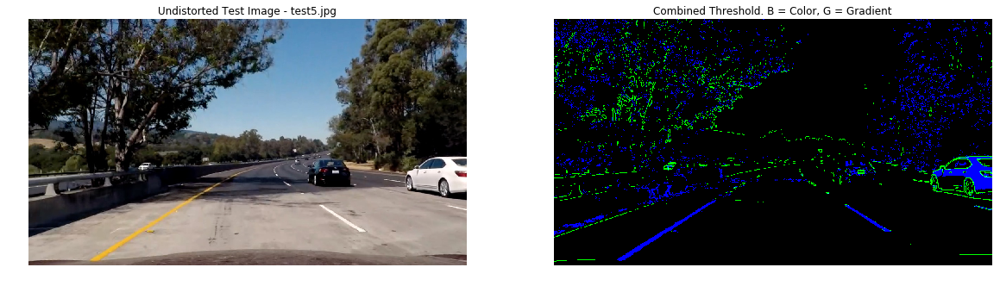

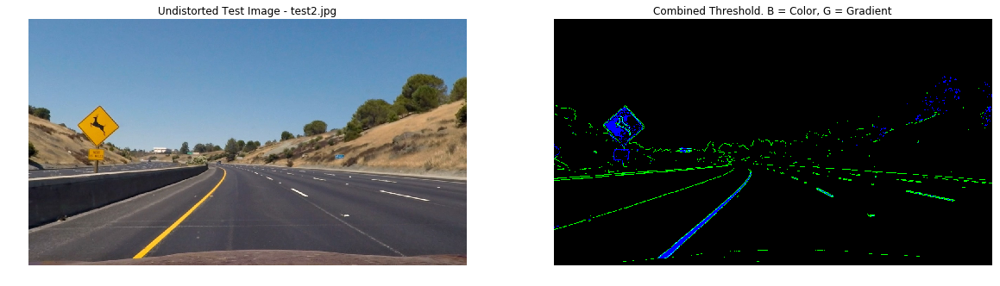

In [5]:
# Combine Gradient + Color Thresholding
def Binary_Threshold(img):    
    gradient_binary = gradient_threshold(img)    
    color_binary = color_threshold(img)       
    combined_binary = np.zeros_like(gradient_binary)
    combined_binary[(gradient_binary == 1) | (color_binary == 1)] = 1
    return combined_binary 


#Used to visualize the two thresholds as Green / Blue
def Binary_Threshold_Color(img):
    gradient_binary = gradient_threshold(img)
    color_binary = color_threshold(img)
    
    output_color = np.dstack(( np.zeros_like(gradient_binary), gradient_binary, color_binary)) *255
    return output_color

#Debugging Binary_Threshold(img):
images = glob.glob(project_path + 'test_images/*.jpg')

for i,fname in enumerate(images):
    raw_img = mpimg.imread(fname) # import image into RGB format
    raw_img_undistort = cv2.undistort(raw_img, mtx,dist,None,mtx)   # undistort image   
    output_binary = Binary_Threshold_Color(raw_img_undistort)
    
    #Generate Plots:
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))    
    ax1.imshow(raw_img_undistort)
    ax1.set_title('Undistorted Test Image - '+fname.split('/')[-1])
    ax1.axis('off')   
    
    ax2.imshow(output_binary)
    ax2.set_title('Combined Threshold. B = Color, G = Gradient')
    ax2.axis('off')

## Perform Perspective Transform

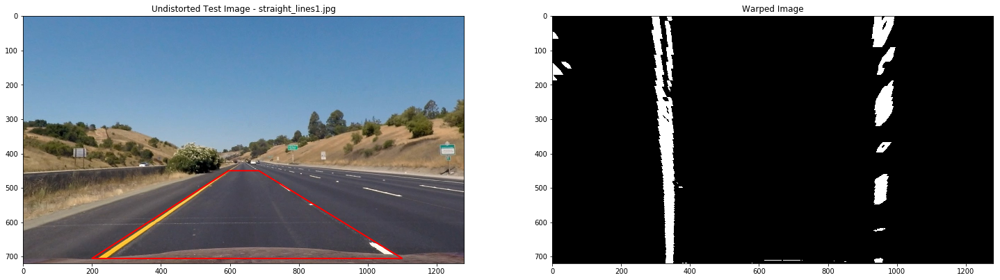

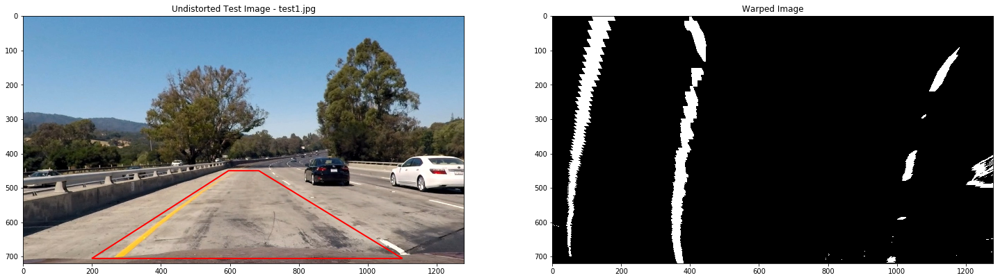

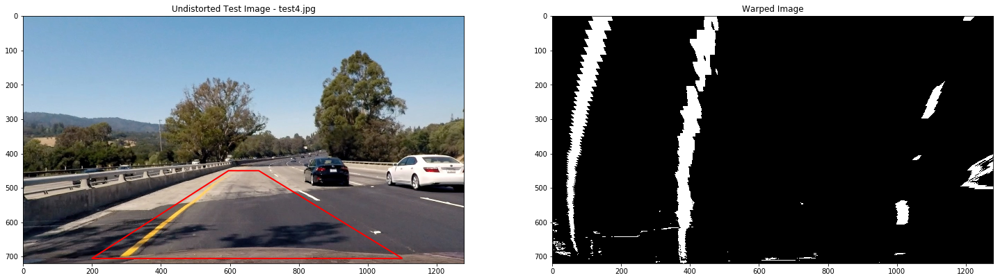

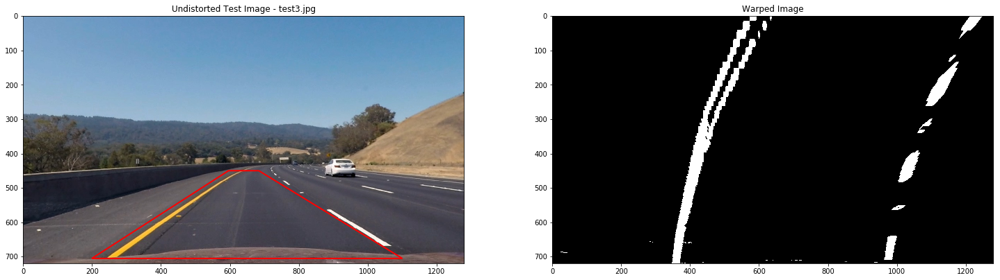

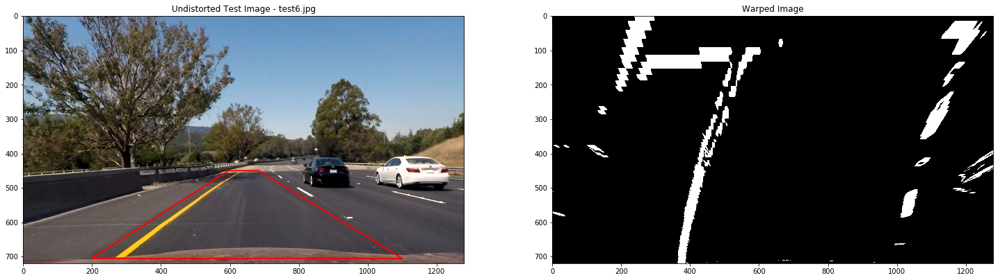

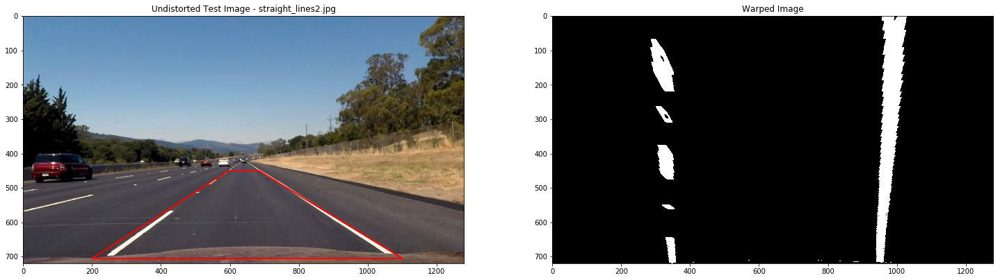

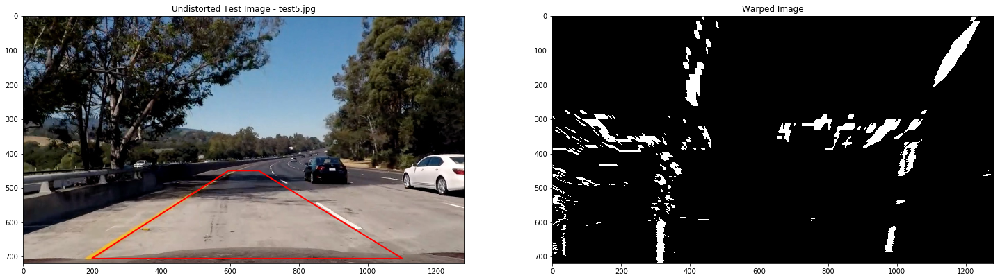

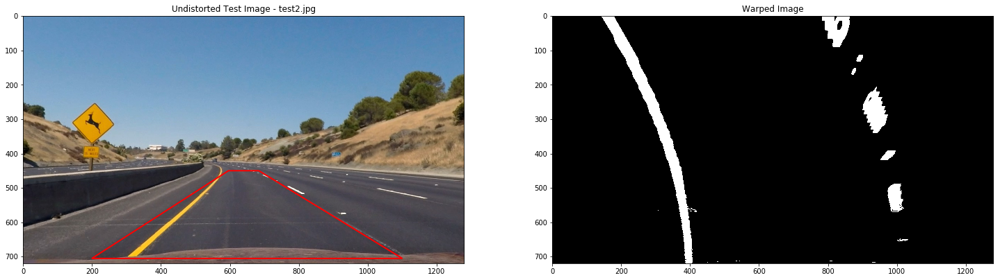

In [6]:
import matplotlib.patches as patches

# Generate Warped  Binary Image for Pipeline
def WarpImage(img,src,dst):
    M = cv2.getPerspectiveTransform(src,dst)    
    return cv2.warpPerspective(img, M, (img.shape[1] , img.shape[0]), flags=cv2.INTER_LINEAR)

# Develop the trapazoid area using sample image:

fname = project_path + 'test_images/test5.jpg'
raw_img = mpimg.imread(fname) # import image 
img_height = raw_img.shape[0]
img_width = raw_img.shape[1]

# Define transformation from area (src):
OffC = 20 # How many pixels camera is off center
bottom_offset = 0.98 # Offset from  bottom of image trapezoid bottom
bottom_width = 0.72 # Width of trapezoid in the foreground
top_width = 0.1# Width of trapezoid in the distance
depth = 0.375 # How far to project into the distance

src = np.float32([[(img_width/2.0)*(1 - bottom_width)+OffC ,img_height*bottom_offset],
                  [(img_width/2.0)*(1 - top_width)+OffC,img_height*(1-depth)], 
                  [(img_width/2.0)*(1 + top_width)-OffC,img_height*(1-depth)],
                  [(img_width/2.0)*(1 + bottom_width) , img_height*bottom_offset] 
                 ])
# Define transformation to area (dst):
offset = 0.25 *img_width
dst = np.float32([[offset,img_height],[offset,0],[img_width-offset,0],[img_width - offset,img_height]])

images = glob.glob(project_path + 'test_images/*.jpg')
for i,fname in enumerate(images):
    raw_img = mpimg.imread(fname) # import image into RGB format

    # Compute Warped Image:
    raw_img_undistort = cv2.undistort(raw_img, mtx,dist,None,mtx) # undistort image   
    output_binary = Binary_Threshold(raw_img_undistort) # Compute Binary Threshold
    output_warp = WarpImage(output_binary,src,dst) # Apply Perspective Transform
    #Generate Plots:
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(25,15))    
    ax1.imshow(raw_img_undistort)
    poly = patches.Polygon(src, fill = False, edgecolor='r', linewidth=2)
    ax1.add_patch(poly) 
    ax1.set_title('Undistorted Test Image - '+fname.split('/')[-1])

    ax2.imshow(output_warp,cmap = 'gray')
    ax2.set_title('Warped Image')

 

## Lane Line Processing


### Define Tracker Class:

In [7]:
# Define tracker class to keep track of the lines in previous frames:

class Tracker():
    def __init__(self,polylimit,calclimit):
        self.LeftCoef = [] # Store left coefficients in history
        self.RightCoef = [] # Store right coefficients in history
        self.CurveRadius = [] # Store curve radius values in history
        self.Offset = [] # Storelane center offset values in history
        self.LastLeftLaneStart = 0 # Position of left lane starting window for previous frame
        self.LastRightLaneStart = 0 # Position of right lane starting window for previous frame
        self.polylimit = polylimit #Averaging history for polynomial coefficients
        self.calclimit = calclimit # Averaging history for lane offset & curvature calculations

    def GetL(self):
        return self.LeftCoef
    
    def GetR(self):
        return self.RightCoef
    
    def GetPolyThreshold(self):
        return self.polylimit
    
    def GetCalcLimit(self):
        return self.calclimit
    
    # Add coefficients to array's
    def AddLines(self,left, right):
        self.LeftCoef.append(left)
        self.RightCoef.append(right)
        
    def AddRadius(self,rad):
        self.CurveRadius.append(rad)
        
    def AddOffset(self,off):
        self.Offset.append(off)      
    
    def UpdatePrevLeftLaneStart(self,left):
        self.LastLeftLaneStart = left
   
    def UpdatePrevRightLaneStart(self,right):
        self.LastRightLaneStart = right

    # Compute Averages:
    def AverageCoef(self):        
        return (np.mean(self.LeftCoef,axis = 0).tolist(),np.mean(self.RightCoef,axis = 0).tolist())
    
    def AverageRadius(self):
        return sum(self.CurveRadius)/len(self.CurveRadius)
    
    def AverageOffset(self):
        return sum(self.Offset)/len(self.Offset)
    
    # Pop oldest values:
    def PopCoef(self):
        self.LeftCoef.pop(0)
        self.RightCoef.pop(0)
    
    def PopRadius(self):
        self.CurveRadius.pop(0)
        
    def PopOffset(self):
        self.Offset.pop(0)

### Fit Lane Line:

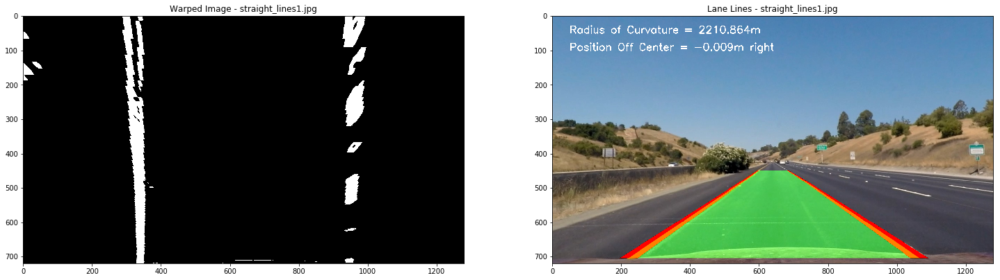

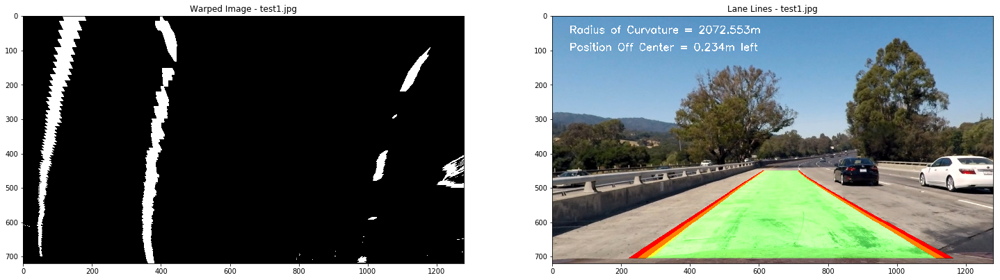

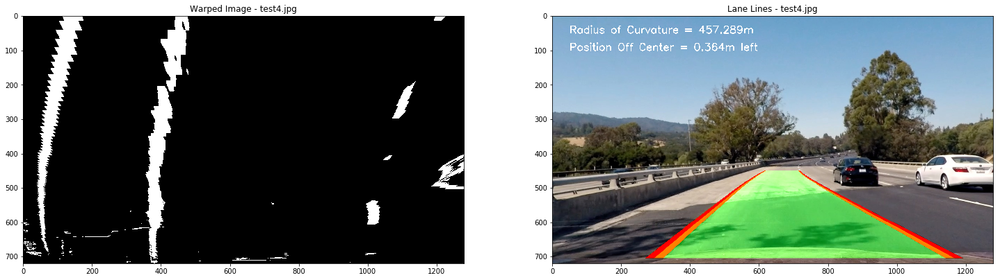

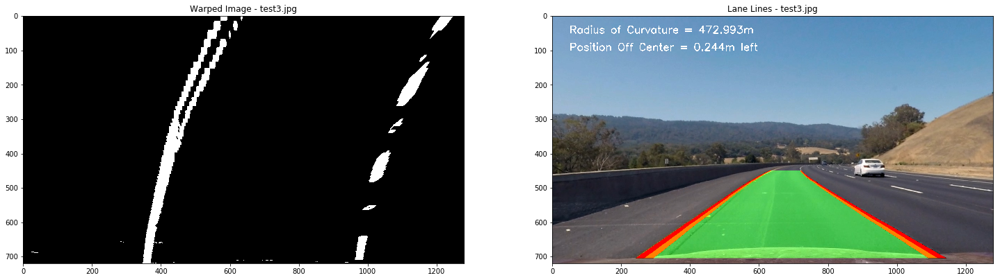

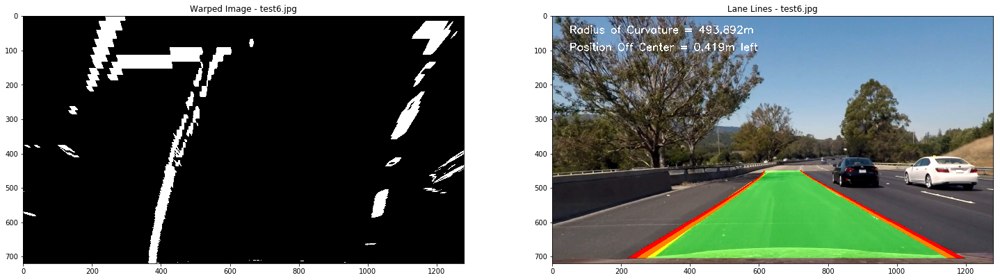

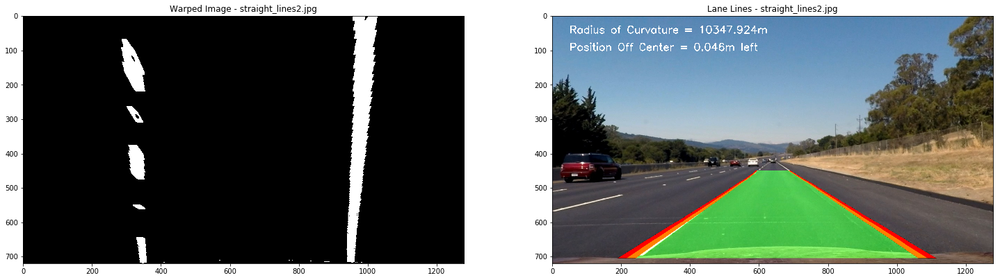

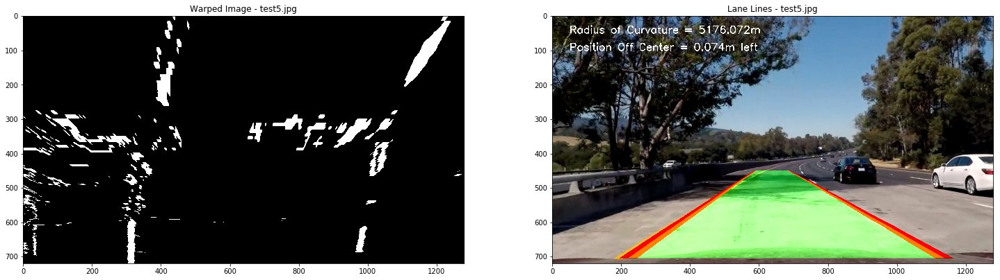

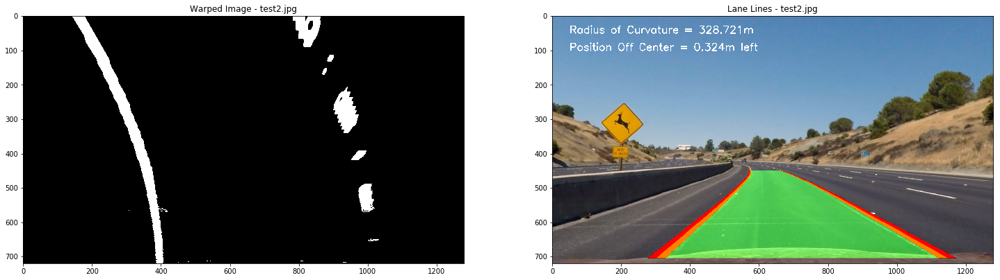

In [8]:
# This piece of code in FitLaneLine takes in the birds eye perspective transform in grayscale as input
# and returns the undistorted image with lane lines superimposed in red. Lane curvature and 
# vehicle center position is also calculated and overlayed on the image.


#Helper function  to draw the window boxes on an image:
def window_mask(width, height, img_ref, center,level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height),
           max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1
    return output        

# FitLaneLine is the main function that computes the curvature, vehicle position offset, 
# and lane line polynomials. This information is superimposed onto the original 
#undistorted image and returned as the sole output.
# ---------------
#Inputs are listed:
# undistorted_img - an undistorted RGB image
# image - 2D perspective transform image, birds eye view, grayscale.
# Minv - Inverse transormation matrix used to warp birds eye back to normal
# frame_counter - Real time frame count of a video
# Tracker - Tracker class object used to keep track of previous frames information
# debug - Whether the function is processing a single images (debug = 1) or 
#         series of images back to back, aka video.(debug = 0)

def FitLaneLine(undistorted_img , image, Minv,frame_counter,Tracker,debug):    
    # Function parameters:    
    window_width = 45 # width of convolution window
    window_height = 80 # Break image into 9 vertical layers since image height is 720
    margin = 70 # How much to slide left and right for searching above current row       
    conv_threshold = 50 # Minimum convolution "count" required to establish new bin    
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    img_height = image.shape[0] # image height
    img_width = image.shape[1]  # image width
    leftx = [] # x values for the left polynomials
    rightx  = [] # x values for the right polynomials 
    L_offset = 75 # Number of pixels to offset left convolution window due to left sholder turbulence
    LaneStartOffset = 50 # maximum number of pixels new lane start point can be offset from previous frame
    
    if(not(debug)):
        # First find the two starting positions for the left and right lane by using np.sum to get
        #the vertical image slice and then np.convolve the vertical image slice with the window template.
        # Sum quarter bottom of image to get slice.
        l_sum = np.sum(image[int(3*img_height/4):,L_offset:int(img_width/2)], axis=0)    
        l_center = np.argmax(np.convolve(window,l_sum))-window_width/2 + L_offset
        r_sum = np.sum(image[int(3*img_height/4):,int(img_width/2):img_width], axis=0)
        r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(image.shape[1]/2)
        
        if(frame_counter != 1):
            # If the calculated lane center position for the new frame is too far away from the
            # previous frame, then use the starting point from  previous frame:
            
            if(np.abs(l_center - Tracker.LastLeftLaneStart) < LaneStartOffset):
                Tracker.UpdatePrevLeftLaneStart(l_center)
            else:
                l_center =  Tracker.LastLeftLaneStart 
            if(np.abs(r_center - Tracker.LastRightLaneStart) < LaneStartOffset):
                Tracker.UpdatePrevRightLaneStart(r_center)
            else:
                r_center =  Tracker.LastRightLaneStart             
        else:
            Tracker.UpdatePrevLeftLaneStart(l_center)
            Tracker.UpdatePrevRightLaneStart(r_center)
            print ("First Frame! Initializing Left and Right Lane Start Points")
    else:    
        l_sum = np.sum(image[int(3*img_height/4):,L_offset:int(img_width/2)], axis=0)    
        l_center = np.argmax(np.convolve(window,l_sum))-window_width/2 + L_offset
        r_sum = np.sum(image[int(3*img_height/4):,int(img_width/2):img_width], axis=0)
        r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(image.shape[1]/2)
   
    # Add what we found for the first layer
    window_centroids.append((l_center,r_center))
    
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(img_height/window_height)):
        
        # convolve the window into the vertical slice of the image
        image_layer = np.sum(image[int(img_height-(level+1)*window_height):
                                   int(img_height-level*window_height),:], axis=0)
        conv_signal = np.convolve(window, image_layer)
        
        # Find the best left centroid by using past left center as a reference
        # Use window_width/2 as offset because convolution signal reference is
        # at right side of window, not center of window
        
        offset = window_width/2
        l_min_index = int(max(l_center+offset-margin,0))
        l_max_index = int(min(l_center+offset+margin,image.shape[1]))
        l_conv = conv_signal[l_min_index:l_max_index] #Compute convolution for left side
        l_conv_max = np.max(l_conv) 
        
        #If the convolution count does not meet threshold, use previous left center
        if(l_conv_max > conv_threshold):
            l_center = np.argmax(l_conv)+l_min_index-offset
        else:
            l_center = l_center
        
        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center+offset-margin,0))
        r_max_index = int(min(r_center+offset+margin,image.shape[1]))
        r_conv = conv_signal[r_min_index:r_max_index]#Compute convolution for right side
        r_conv_max = np.max(r_conv)
        
        #If the convolution count does not meet threshold, use previous old center
        if(r_conv_max > conv_threshold):
            r_center = np.argmax(r_conv)+r_min_index-offset
        else:
            r_center = r_center        

        # Add what we found for that layer
        window_centroids.append((l_center,r_center))

    # If we found any window centers
    if len(window_centroids) > 0:

        # Points used to draw all the left and right windows
        l_points = np.zeros_like(warped)
        r_points = np.zeros_like(warped)

        # Go through each level and draw the windows
        for level in range(0,len(window_centroids)):
                                 
            #Add points for generating polynomial:
            leftx.append(window_centroids[level][0])
            rightx.append(window_centroids[level][1])            
            
            # Window_mask is a function to draw window areas
            l_mask = window_mask(window_width,window_height,warped,window_centroids[level][0],level)            
            r_mask = window_mask(window_width,window_height,warped,window_centroids[level][1],level)
            
            # Add graphic points from window mask here to total pixels found 
            l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
            r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255

            # Draw the results
            template = np.array(r_points+l_points,np.uint8) # add both left and right window pixels together
            zero_channel = np.zeros_like(template) # create a zero color channel
            template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
            warpage= np.dstack((warped, warped, warped))*255 # making the original road pixels 3 color channels
            drawCentroids = cv2.addWeighted(warpage, 1, template, 0.5, 0.0) # overlay the orignal road image with window results

    # If no window centers found, just use orginal road image
    else:
        drawCentroids = np.array(cv2.merge((warped,warped,warped)),np.uint8)
    
    # Compute Line Fit :z`
 
    # y-values corresponding to the middle of each window, starting from bottom up
    window_yvals = np.arange(img_height - window_height/2, 0 ,-window_height )    
    # Compute polynomial coefficents for current image, f(y) = x = a*y*y + b*y + c     
    lpoly = np.polyfit(window_yvals , leftx , 2).tolist()
    rpoly = np.polyfit(window_yvals , rightx , 2).tolist()
    
    # Average coeffients based on previous readings (only if we arent in debug): 
    if (debug):
        left_poly = lpoly
        right_poly = rpoly    
    else:        
        if(frame_counter  > Tracker.GetPolyThreshold()):
            Tracker.PopCoef() 
        Tracker.AddLines(lpoly,rpoly)        
        left_poly,right_poly = Tracker.AverageCoef()
        
    # Map polynomial equation to a continuous line spanning entire image height:
    yvals = np.array(range(0,img_height))
    left_poly_x = np.array(left_poly[0]*yvals*yvals + left_poly[1]*yvals + left_poly[2],np.int32)
    right_poly_x = np.array(right_poly[0]*yvals*yvals + right_poly[1]*yvals + right_poly[2],np.int32)

    # Draw both left and right lane lines:
        
    # Generate list of points representing each lane line [(y1,x1),(y2,x2)...(y720,x720)]
    # For polylines()
    L_points = np.vstack((left_poly_x , yvals )).T
    L_points.reshape(-1,1,2)
    R_points = np.vstack((right_poly_x , yvals )).T
    R_points.reshape(-1,1,2)
        
    # Map combined pts for fillPoly()
    pts_l = np.array([np.transpose(np.vstack([left_poly_x, yvals]))])
    pts_r = np.array([np.flipud(np.transpose(np.vstack([right_poly_x, yvals])))])
    combined_pts = np.hstack((pts_l, pts_r))
    
    # Insert points onto a blank image:
    zeros = np.zeros_like(warped)
    points_img = np.zeros_like(warped)
    road_bkg = np.zeros_like(warped)
    road = np.zeros_like(warped)
    lane_area= np.dstack((zeros, zeros, zeros)) # Image to overlay middle lane area
    thickness = 35

    # Create art
    cv2.polylines(points_img,[L_points], False, (255,255,255), thickness)    
    cv2.polylines(points_img, [R_points], False,  (255,255,255) ,thickness)
    cv2.fillPoly(lane_area, ([combined_pts]), (0,255, 0))
    
    road = np.array(cv2.merge((points_img, zeros,zeros)),np.uint8)
    road_bkg = np.array(cv2.merge((points_img, points_img,points_img)),np.uint8)
    
    '''
    # Draw lines on 2D birds-eye perspective (debugging):
    base = cv2.addWeighted(drawCentroids, 1, road_bkg, -1, 0.0)
    Lines_Perspective = cv2.addWeighted(base, 1, road, 1, 0.0)  
    '''

    # Draw Lines & UnWarp Image back to normal perspective:
    img_size = (zeros.shape[1],zeros.shape[0])     
    road_warped = cv2.warpPerspective(road,Minv,img_size,flags = cv2.INTER_LINEAR)
    road_warped_bkg = cv2.warpPerspective(road_bkg,Minv,img_size,flags = cv2.INTER_LINEAR)
    lane_area_warped = cv2.warpPerspective(lane_area,Minv,img_size,flags = cv2.INTER_LINEAR)
    
    # Superimpose lane lines & lane area over original undistorted image:    
    base = cv2.addWeighted(undistorted_img, 1, road_warped_bkg, -1, 0.0)
    result = cv2.addWeighted(base, 1, road_warped, 1, 0.0)  
    result = cv2.addWeighted(result, 1, lane_area_warped, 0.5, 0.0) 
    
    # Compute Curvature:
    
    # Pixel to Meters Conversion Factor's in x and y:
    ym_per_pix = 30./720
    xm_per_pix = 3.7/600
    
    # Scale the polynomials to meters:     
    left_fit_meters  = [left_poly[0]*xm_per_pix/(ym_per_pix**2),
                        left_poly[1]*xm_per_pix/ym_per_pix,
                        left_poly[2]]
    right_fit_meters  = [right_poly[0]*xm_per_pix/(ym_per_pix**2),
                         right_poly[1]*xm_per_pix/ym_per_pix,
                         right_poly[2]]
    
    # Choose y value to calculate curvature ( in meters )
    y_eval = np.max(yvals)*ym_per_pix
    
    # Curvature Calculation & Display:
    left_curverad = ((1 + (2*left_fit_meters[0]*y_eval + left_fit_meters[1])**2)**1.5)/np.absolute(2*left_fit_meters[0])
    right_curverad = ((1 + (2*right_fit_meters[0]*y_eval + right_fit_meters[1])**2)**1.5)/np.absolute(2*right_fit_meters[0])
    radius_avg = (left_curverad + right_curverad) / 2.0

    #Calculate vehicle distance from center:    
    
    vehicle_center = img_width/2 # Compute the center of the vehicle
    lane_center = round((leftx[0] + rightx[0]) / 2.0,1) # Compute the center of the lane based on start points                                
    pixel_off_center = (lane_center - vehicle_center)  # Compute number of pixels vehicle is off center
    offC = pixel_off_center*xm_per_pix # Convert pixels to meters
    side_pos = 'left'
    if(offC <= 0):
        side_pos = 'right'    
    
    # Average Curvature & Vehicle Offset using Tracker class:
    if (not(debug)):        
        if( frame_counter > Tracker.GetCalcLimit() ):
            Tracker.PopRadius()
            Tracker.PopOffset()
        Tracker.AddRadius(radius_avg)
        Tracker.AddOffset(offC)
        
        off_center = Tracker.AverageOffset()
        curverad = Tracker.AverageRadius()        
        
    else:
        off_center = offC
        curverad = radius_avg
    
    # Display curvature and position offset on image:
    cv2.putText(result,'Radius of Curvature = ' + str(round(curverad,3)) + "m", (50,50),
                cv2.FONT_HERSHEY_SIMPLEX,1,(255,255,255),2)
    cv2.putText(result,'Position Off Center = ' + str(round(off_center,3)) + "m "+ side_pos , (50,100),
                cv2.FONT_HERSHEY_SIMPLEX,1,(255,255,255),2)    
 
    return result


#Visual Debugging:

images = glob.glob(project_path + 'test_images/*.jpg')
for i,fname in enumerate(images):
    raw_img = mpimg.imread(fname) # import image into RGB format
    # Compute Warped Image:   
    
    raw_img_undistort = cv2.undistort(raw_img, mtx,dist,None,mtx) # undistort image   
    output_binary = Binary_Threshold(raw_img_undistort) # Compute Binary Threshold
    warped = WarpImage(output_binary,src,dst) # Apply Perspective Transform
    Minv = cv2.getPerspectiveTransform(dst,src)
    
    Coefficients = Tracker(15,50)
    debug = True
    result = FitLaneLine(raw_img_undistort,warped, Minv,0, Coefficients,debug)    
    
    #Generate Plots:

    f, (ax1,ax2) = plt.subplots(1, 2, figsize=(25,15)) 
    ax1.imshow(warped, cmap = 'gray')
    ax1.set_title('Warped Image - '+ fname.split('/')[-1])
    ax2.imshow(result)
    ax2.set_title('Lane Lines - '+ fname.split('/')[-1])






## Concatenate the Pipeline


In [9]:
# Summarize the entire processing pipeline into a single function

# Setup Global variables to utilize Tracker class in process_image
global Coef
global frame_count
frame_count = 0
Coef = Tracker(10,50)
def process_image(img):
    raw_img_undistort = cv2.undistort(img, mtx,dist,None,mtx) # undistort image   
    output_binary = Binary_Threshold(raw_img_undistort) # Compute Binary Threshold
    warped = WarpImage(output_binary,src,dst) # Apply Perspective Transform  
    Minv = cv2.getPerspectiveTransform(dst,src)   
    global frame_count
    frame_count = frame_count+1
    result = FitLaneLine(raw_img_undistort,warped, Minv, frame_count ,Coef, False )    
 
    return result

---
## Apply pipeline on project video

In [10]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

output_video = "output_video_2.mp4" 
test_video = "project_video.mp4"

#clip1 = VideoFileClip(test_video).subclip(30,50)
clip1 = VideoFileClip(test_video)
process_clip = clip1.fl_image(process_image)
process_clip.write_videofile(output_video, audio=False)

First Frame! Initializing Left and Right Lane Start Points
[MoviePy] >>>> Building video output_video_2.mp4
[MoviePy] Writing video output_video_2.mp4


100%|█████████▉| 1260/1261 [03:16<00:00,  7.34it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_video_2.mp4 

